# EDA of the Ages Dataset 2023

## Download Additional Libraries

## Import Libraries

In [2]:
from tqdm import tqdm
import pandas as pd
import numpy as np

import missingno as msno
import matplotlib.pyplot as plt
import seaborn as sns

from wordcloud import WordCloud

import folium
from folium.plugins import FastMarkerCluster

%matplotlib inline

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


## Load Dataset

In [4]:
df = pd.read_csv("ages_dataset.csv")

## Initial EDA 🔍 (Explolatory Data Analysis)

In [5]:
df.head()

,Id,Name,Short description,Gender,Country,Occupation,Birth year,Death year,Manner of death,Age of death,Associated Countries,Associated Country Coordinates (Lat/Lon),Associated Country Life Expectancy
0,Q23,George Washington,1st president of the United States (1732–1799),Male,United States of America; Kingdom of Great Bri...,Politician,1732,1799.0,natural causes,67.0,"['United Kingdom', 'United States']","[(55.378051, -3.435973), (37.09024, -95.712891)]","[81.3, 78.5]"
1,Q42,Douglas Adams,English writer and humorist,Male,United Kingdom,Artist,1952,2001.0,natural causes,49.0,['United Kingdom'],"[(55.378051, -3.435973)]",[81.3]
2,Q91,Abraham Lincoln,16th president of the United States (1809-1865),Male,United States of America,Politician,1809,1865.0,homicide,56.0,['United States'],"[(37.09024, -95.712891)]",[78.5]
3,Q254,Wolfgang Amadeus Mozart,Austrian composer of the Classical period,Male,Archduchy of Austria; Archbishopric of Salzburg,Artist,1756,1791.0,NaN,35.0,['Austria'],"[(47.516231, 14.550072)]",[81.6]
4,Q255,Ludwig van Beethoven,German classical and romantic composer,Male,Holy Roman Empire; Austrian Empire,Artist,1770,1827.0,NaN,57.0,"['Austria', 'Italy']","[(47.516231, 14.550072), (41.87194, 12.56738)]","[81.6, 82.9]"


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1223009 entries, 0 to 1223008
Data columns (total 13 columns):
 #   Column                                    Non-Null Count    Dtype  
---  ------                                    --------------    -----  
 0   Id                                        1223009 non-null  object 
 1   Name                                      1223009 non-null  object 
 2   Short description                         1155109 non-null  object 
 3   Gender                                    1089363 non-null  object 
 4   Country                                   887500 non-null   object 
 5   Occupation                                1016095 non-null  object 
 6   Birth year                                1223009 non-null  int64  
 7   Death year                                1223008 non-null  float64
 8   Manner of death                           53603 non-null    object 
 9   Age of death                              1223008 non-null  float64
 10  Associ

In [7]:
df.describe()

,Birth year,Death year,Age of death
count,1.223009e+06,1.223008e+06,1.223008e+06
mean,1.844972e+03,1.914246e+03,6.927406e+01
std,1.479390e+02,1.516898e+02,1.662938e+01
min,-2.700000e+03,-2.659000e+03,0.000000e+00
25%,1.828000e+03,1.895000e+03,6.000000e+01
50%,1.887000e+03,1.955000e+03,7.200000e+01
75%,1.918000e+03,1.994000e+03,8.100000e+01
max,2.016000e+03,2.021000e+03,1.690000e+02


## Data Cleaning 🧹 - Drop Unwanted Columns

In [8]:
# Drop the "id" column
df = df.drop('Id', axis=1)

In [9]:
df.head()

,Name,Short description,Gender,Country,Occupation,Birth year,Death year,Manner of death,Age of death,Associated Countries,Associated Country Coordinates (Lat/Lon),Associated Country Life Expectancy
0,George Washington,1st president of the United States (1732–1799),Male,United States of America; Kingdom of Great Bri...,Politician,1732,1799.0,natural causes,67.0,"['United Kingdom', 'United States']","[(55.378051, -3.435973), (37.09024, -95.712891)]","[81.3, 78.5]"
1,Douglas Adams,English writer and humorist,Male,United Kingdom,Artist,1952,2001.0,natural causes,49.0,['United Kingdom'],"[(55.378051, -3.435973)]",[81.3]
2,Abraham Lincoln,16th president of the United States (1809-1865),Male,United States of America,Politician,1809,1865.0,homicide,56.0,['United States'],"[(37.09024, -95.712891)]",[78.5]
3,Wolfgang Amadeus Mozart,Austrian composer of the Classical period,Male,Archduchy of Austria; Archbishopric of Salzburg,Artist,1756,1791.0,NaN,35.0,['Austria'],"[(47.516231, 14.550072)]",[81.6]
4,Ludwig van Beethoven,German classical and romantic composer,Male,Holy Roman Empire; Austrian Empire,Artist,1770,1827.0,NaN,57.0,"['Austria', 'Italy']","[(47.516231, 14.550072), (41.87194, 12.56738)]","[81.6, 82.9]"


## Data Cleaning 🧹 - Null Values

In [10]:
# Quick Glance at Null Values 
df.isnull().sum()

Name                                              0
Short description                             67900
Gender                                       133646
Country                                      335509
Occupation                                   206914
Birth year                                        0
Death year                                        1
Manner of death                             1169406
Age of death                                      1
Associated Countries                         368693
Associated Country Coordinates (Lat/Lon)     368693
Associated Country Life Expectancy           368930
dtype: int64

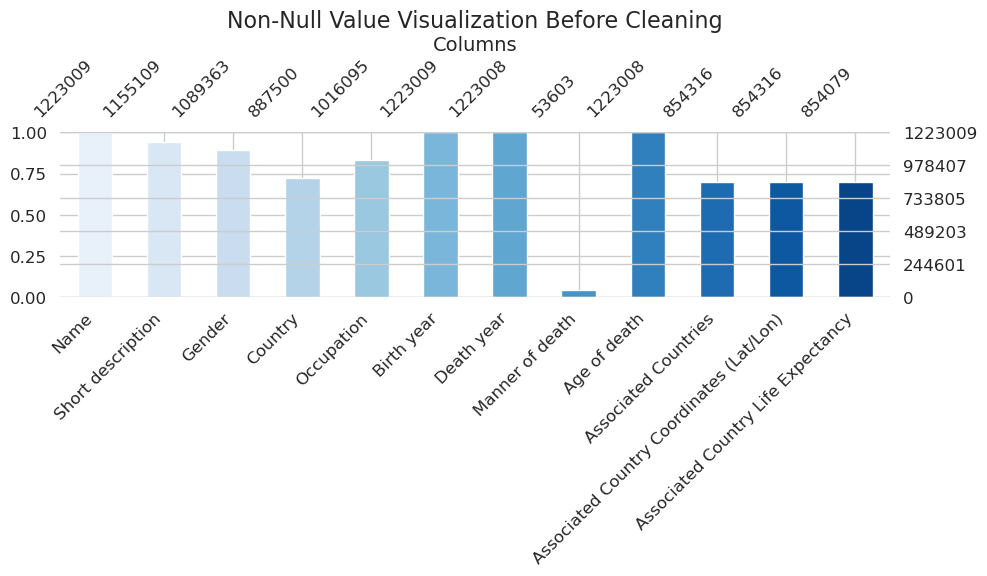

In [11]:
# Visualize Null Values Before Cleaning
sns.set(style='whitegrid', font_scale=1.2)
msno.bar(df, color=sns.color_palette('Blues', n_colors=len(df.columns)), figsize=(10, 6), fontsize=12, labels=True)

plt.title('Non-Null Value Visualization Before Cleaning', fontsize=16)
plt.xlabel('Columns', fontsize=14)
plt.ylabel('Percentage of Missing Values', fontsize=14)
plt.xticks(rotation=45, ha='right')

plt.tight_layout()
plt.show()

In [12]:
# For Visualization Purposes:
# Lets Drop rows with null values in 'occupation', 'associated_countries', and 'death_year'
df = df.dropna(subset=['Occupation', 'Associated Countries', 'Death year'], how='any')

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 782779 entries, 0 to 1223008
Data columns (total 12 columns):
 #   Column                                    Non-Null Count   Dtype  
---  ------                                    --------------   -----  
 0   Name                                      782779 non-null  object 
 1   Short description                         778748 non-null  object 
 2   Gender                                    713089 non-null  object 
 3   Country                                   782779 non-null  object 
 4   Occupation                                782779 non-null  object 
 5   Birth year                                782779 non-null  int64  
 6   Death year                                782779 non-null  float64
 7   Manner of death                           44874 non-null   object 
 8   Age of death                              782779 non-null  float64
 9   Associated Countries                      782779 non-null  object 
 10  Associated Country 

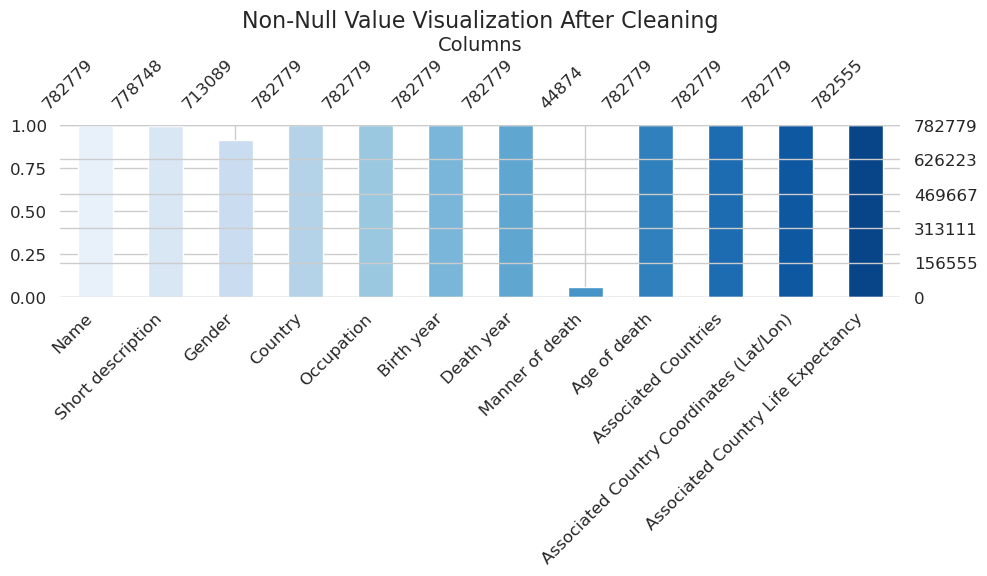

In [14]:
# Visualize Null Values After Cleaning
sns.set(style='whitegrid', font_scale=1.2)
msno.bar(df, color=sns.color_palette('Blues', n_colors=len(df.columns)), figsize=(10, 6), fontsize=12, labels=True)

plt.title('Non-Null Value Visualization After Cleaning', fontsize=16)
plt.xlabel('Columns', fontsize=14)
plt.ylabel('Percentage of Missing Values', fontsize=14)
plt.xticks(rotation=45, ha='right')

plt.tight_layout()
plt.show()

## Drilling Deeper Into EDA 🔍 - Correlations

In [15]:
# Make a Copy of the Dataframe for EDA Purposes
eda_df = df.copy()

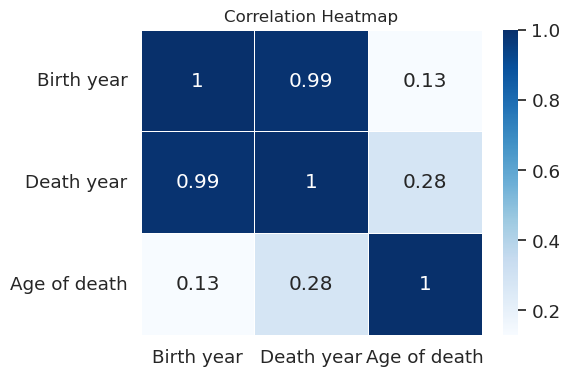

In [16]:
# Create a correlation heatmap for numerical Features
correlation_matrix = eda_df.corr()
plt.figure(figsize=(6, 4))
sns.heatmap(correlation_matrix, annot=True, cmap='Blues', linewidths=0.5)
plt.title('Correlation Heatmap', fontsize=12)


plt.tight_layout()
plt.show()

<Figure size 1200x1200 with 0 Axes>

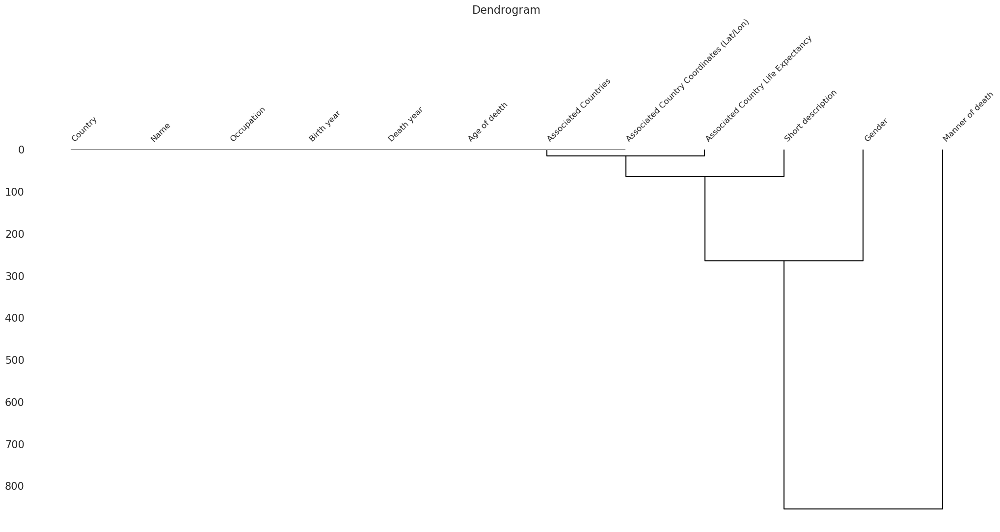

In [17]:
# Create a Dendrogram To Visuliaze the Correlation
plt.figure(figsize=(12, 12))
msno.dendrogram(df, fontsize=12)
plt.title('Dendrogram', fontsize=16)

plt.show();

## Data Preprocesing ⚒️

In [18]:
processed_df = df.copy()

In [19]:
# Adding a New Column Called Number of Citizenships depending on number of countries the person was associated with
processed_df['Number of Citizenships'] = processed_df['Country'].apply(lambda x: len(x.split(';')))

In [20]:
def calculate_average(value):
    try:
        val = eval(value)
    except:
        return np.nan
    
    return np.mean(val)

In [21]:
processed_df['Expected Life Expectancy'] = df['Associated Country Life Expectancy'].apply(calculate_average)

In [22]:
processed_df.head()

,Name,Short description,Gender,Country,Occupation,Birth year,Death year,Manner of death,Age of death,Associated Countries,Associated Country Coordinates (Lat/Lon),Associated Country Life Expectancy,Number of Citizenships,Expected Life Expectancy
0,George Washington,1st president of the United States (1732–1799),Male,United States of America; Kingdom of Great Bri...,Politician,1732,1799.0,natural causes,67.0,"['United Kingdom', 'United States']","[(55.378051, -3.435973), (37.09024, -95.712891)]","[81.3, 78.5]",2,79.90
1,Douglas Adams,English writer and humorist,Male,United Kingdom,Artist,1952,2001.0,natural causes,49.0,['United Kingdom'],"[(55.378051, -3.435973)]",[81.3],1,81.30
2,Abraham Lincoln,16th president of the United States (1809-1865),Male,United States of America,Politician,1809,1865.0,homicide,56.0,['United States'],"[(37.09024, -95.712891)]",[78.5],1,78.50
3,Wolfgang Amadeus Mozart,Austrian composer of the Classical period,Male,Archduchy of Austria; Archbishopric of Salzburg,Artist,1756,1791.0,NaN,35.0,['Austria'],"[(47.516231, 14.550072)]",[81.6],2,81.60
4,Ludwig van Beethoven,German classical and romantic composer,Male,Holy Roman Empire; Austrian Empire,Artist,1770,1827.0,NaN,57.0,"['Austria', 'Italy']","[(47.516231, 14.550072), (41.87194, 12.56738)]","[81.6, 82.9]",2,82.25


Convert String to Array since When you load the CSV the arrays will be saved as strings

In [23]:
def convert_string_to_array(value):
    try:
        val = eval(value)
        return val
    except:
        return np.nan

In [24]:
processed_df["Associated Countries"] = processed_df["Associated Countries"].apply(convert_string_to_array)

In [25]:
processed_df["Associated Country Life Expectancy"] = processed_df["Associated Country Life Expectancy"].apply(convert_string_to_array)

In [26]:
processed_df["Associated Country Coordinates (Lat/Lon)"] = processed_df["Associated Country Coordinates (Lat/Lon)"].apply(convert_string_to_array)

In [27]:
processed_df.head()

,Name,Short description,Gender,Country,Occupation,Birth year,Death year,Manner of death,Age of death,Associated Countries,Associated Country Coordinates (Lat/Lon),Associated Country Life Expectancy,Number of Citizenships,Expected Life Expectancy
0,George Washington,1st president of the United States (1732–1799),Male,United States of America; Kingdom of Great Bri...,Politician,1732,1799.0,natural causes,67.0,"[United Kingdom, United States]","[(55.378051, -3.435973), (37.09024, -95.712891)]","[81.3, 78.5]",2,79.90
1,Douglas Adams,English writer and humorist,Male,United Kingdom,Artist,1952,2001.0,natural causes,49.0,[United Kingdom],"[(55.378051, -3.435973)]",[81.3],1,81.30
2,Abraham Lincoln,16th president of the United States (1809-1865),Male,United States of America,Politician,1809,1865.0,homicide,56.0,[United States],"[(37.09024, -95.712891)]",[78.5],1,78.50
3,Wolfgang Amadeus Mozart,Austrian composer of the Classical period,Male,Archduchy of Austria; Archbishopric of Salzburg,Artist,1756,1791.0,NaN,35.0,[Austria],"[(47.516231, 14.550072)]",[81.6],2,81.60
4,Ludwig van Beethoven,German classical and romantic composer,Male,Holy Roman Empire; Austrian Empire,Artist,1770,1827.0,NaN,57.0,"[Austria, Italy]","[(47.516231, 14.550072), (41.87194, 12.56738)]","[81.6, 82.9]",2,82.25


Convert Multi Value Columns into Array Values

In [28]:
def break_string_to_array(value):
    if type(value) == float:
        return np.nan
    
    if ";" in value:
        arr =value.split(";")
    else:
        arr = [value]
    
    arr = [x.strip() for x in arr]
    return arr

In [29]:
processed_df['Occupation'] = processed_df['Occupation'].apply(break_string_to_array)

In [30]:
processed_df['Manner of death'] = processed_df['Manner of death'].apply(break_string_to_array)

In [31]:
def get_first_value_only(value):
    if type(value) == float:
        return np.nan
    
    if ";" in value:
        arr =value.split(";")
    else:
        arr = [value]
    
    arr = [x.strip() for x in arr]
    return arr[0]

In [32]:
processed_df["Gender"] = processed_df["Gender"].apply(get_first_value_only)

In [33]:
processed_df.head()

,Name,Short description,Gender,Country,Occupation,Birth year,Death year,Manner of death,Age of death,Associated Countries,Associated Country Coordinates (Lat/Lon),Associated Country Life Expectancy,Number of Citizenships,Expected Life Expectancy
0,George Washington,1st president of the United States (1732–1799),Male,United States of America; Kingdom of Great Bri...,[Politician],1732,1799.0,[natural causes],67.0,"[United Kingdom, United States]","[(55.378051, -3.435973), (37.09024, -95.712891)]","[81.3, 78.5]",2,79.90
1,Douglas Adams,English writer and humorist,Male,United Kingdom,[Artist],1952,2001.0,[natural causes],49.0,[United Kingdom],"[(55.378051, -3.435973)]",[81.3],1,81.30
2,Abraham Lincoln,16th president of the United States (1809-1865),Male,United States of America,[Politician],1809,1865.0,[homicide],56.0,[United States],"[(37.09024, -95.712891)]",[78.5],1,78.50
3,Wolfgang Amadeus Mozart,Austrian composer of the Classical period,Male,Archduchy of Austria; Archbishopric of Salzburg,[Artist],1756,1791.0,NaN,35.0,[Austria],"[(47.516231, 14.550072)]",[81.6],2,81.60
4,Ludwig van Beethoven,German classical and romantic composer,Male,Holy Roman Empire; Austrian Empire,[Artist],1770,1827.0,NaN,57.0,"[Austria, Italy]","[(47.516231, 14.550072), (41.87194, 12.56738)]","[81.6, 82.9]",2,82.25


## Data Visualization - Visualizing the Gender Distribution

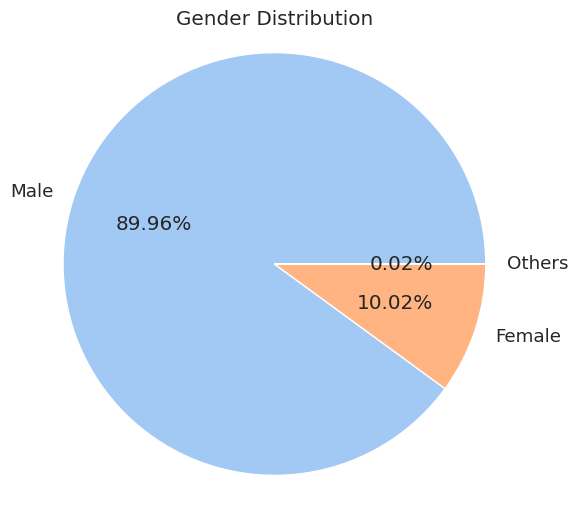

In [34]:
# Count the occurrences of each gender
gender_counts = processed_df['Gender'].value_counts()

# Combine other genders into "Others"
others_count = gender_counts[~gender_counts.index.isin(['Male', 'Female'])].sum()
gender_counts = gender_counts[gender_counts.index.isin(['Male', 'Female'])]
gender_counts['Others'] = others_count

# Create a pie chart using pyplot
plt.figure(figsize=(6, 6))
plt.pie(gender_counts, labels=gender_counts.index, autopct='%1.2f%%', colors=sns.color_palette('pastel'))
plt.title('Gender Distribution')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

# Display the pie chart
plt.show()

## Data Visualization - Ages at which People Died

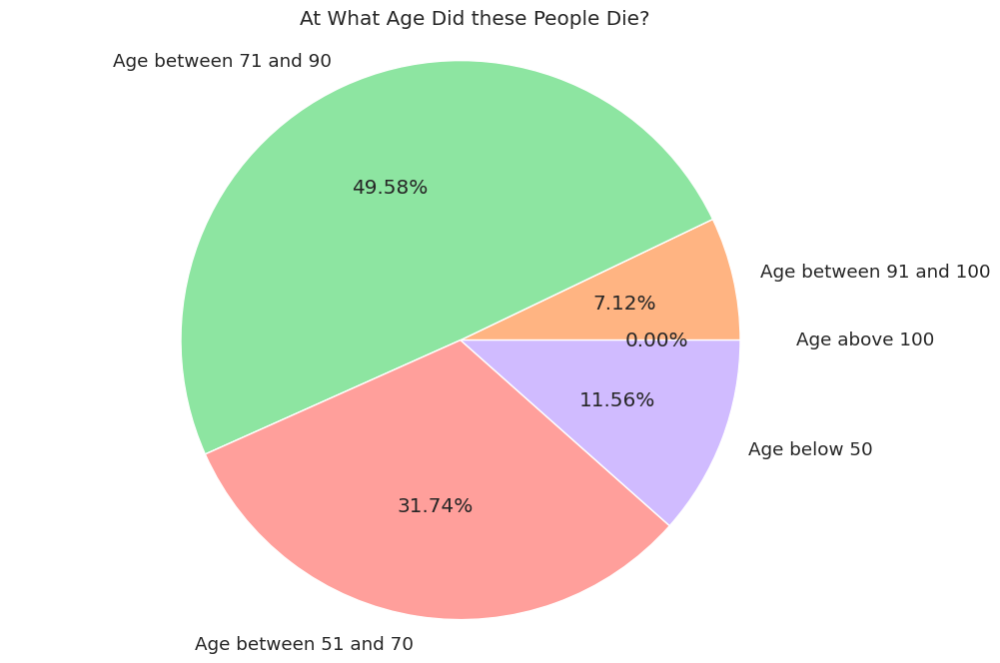

In [35]:
# Calculate the number of people in each age range
count = [
    processed_df[processed_df['Age of death'] > 100].shape[0],
    processed_df[(processed_df['Age of death'] <= 100) & (processed_df['Age of death'] > 90)].shape[0],
    processed_df[(processed_df['Age of death'] <= 90) & (processed_df['Age of death'] > 70)].shape[0],
    processed_df[(processed_df['Age of death'] <= 70) & (processed_df['Age of death'] > 50)].shape[0],
    processed_df.shape[0] - (processed_df[processed_df['Age of death'] > 100].shape[0]
                  + processed_df[(processed_df['Age of death'] <= 100) & (processed_df['Age of death'] > 90)].shape[0]
                  + processed_df[(processed_df['Age of death'] <= 70) & (processed_df['Age of death'] > 50)].shape[0]
                  + processed_df[(processed_df['Age of death'] <= 90) & (df['Age of death'] > 70)].shape[0])
]

# Define age ranges for the labels
age_ranges = ['Age above 100', 'Age between 91 and 100', 'Age between 71 and 90', 'Age between 51 and 70', 'Age below 50']

# Define the explode to highlight the first slice (age > 100)
explode = [0.1, 0, 0, 0, 0]

# Define Seaborn color palette to use
palette_color = sns.color_palette('pastel')

# Create a pie chart using pyplot
plt.figure(figsize=(12, 8))
plt.pie(count, labels=age_ranges, colors=palette_color, explode=explode, autopct='%.2f%%')
plt.title("At What Age Did these People Die?")
plt.axis('equal')  

plt.show()

## Data Visualization - Top 10 Most Represented Countries

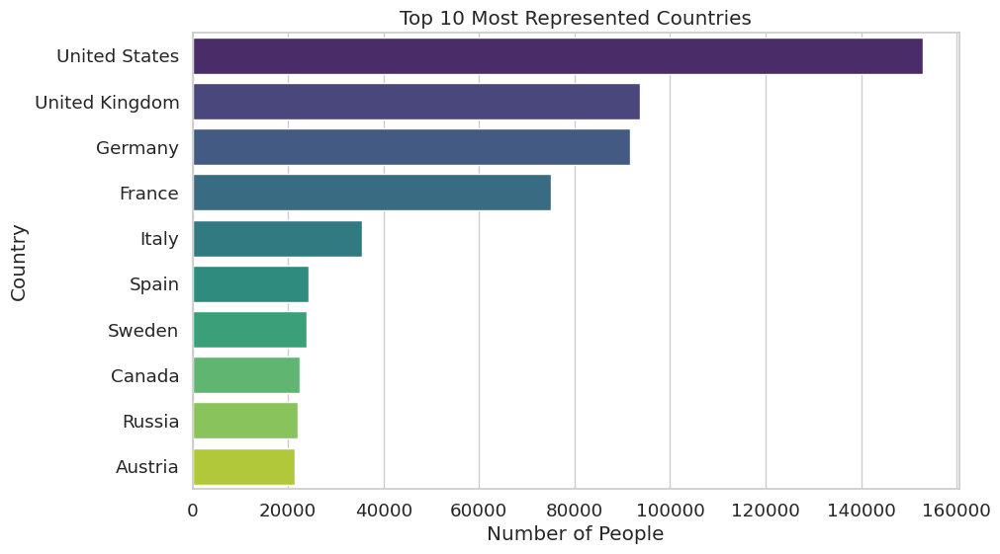

In [36]:
# Convert the arrays in the 'Associated Countries' column to individual rows using explode()
df_exploded =  processed_df.explode('Associated Countries')

# Count the occurrences of each country
top_countries = df_exploded['Associated Countries'].value_counts().reset_index()
top_countries.columns = ['Country', 'Count']

# Filter the top 10 most represented countries
top_countries = top_countries.head(10)

# Create a bar chart using Seaborn
plt.figure(figsize=(10, 6))
sns.barplot(data=top_countries, x='Count', y='Country', palette='viridis')
plt.title('Top 10 Most Represented Countries')
plt.xlabel('Number of People')
plt.ylabel('Country')
plt.show()

## Data Visualization - Birth Year Distibution

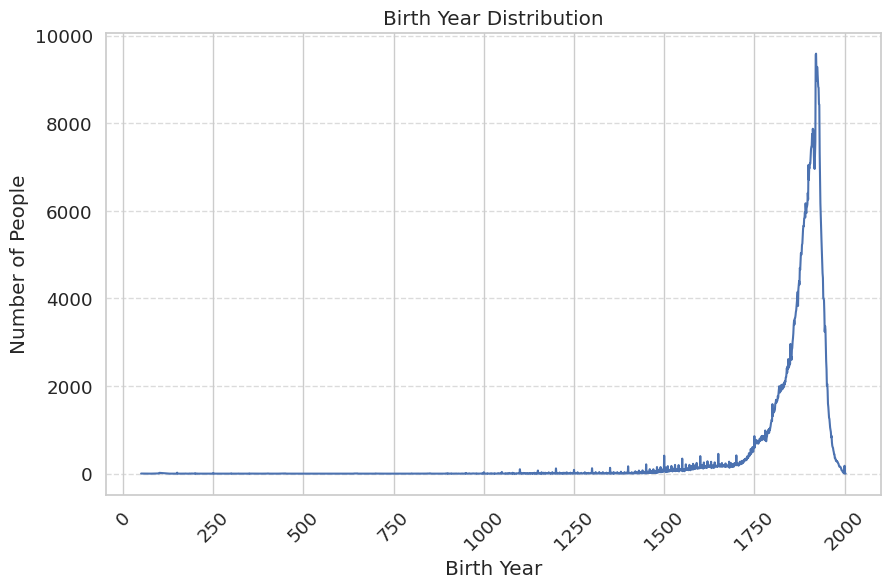

In [37]:
# Filter out birth years that are above 0
filtered_df = processed_df[processed_df['Birth year'] > 0]

# Group the data by birth year and count the occurrences
birth_year_counts = filtered_df['Birth year'].value_counts().reset_index()
birth_year_counts.columns = ['Birth year', 'Count']
birth_year_counts = birth_year_counts.sort_values('Birth year')

# Create a line plot using Seaborn
plt.figure(figsize=(10, 6))
sns.lineplot(data=birth_year_counts, x='Birth year', y='Count', color='b')
plt.title('Birth Year Distribution')
plt.xlabel('Birth Year')
plt.ylabel('Number of People')
plt.xticks(rotation=45)
plt.grid(True, axis='y', linestyle='--', alpha=0.7)
plt.show()

## Data Visualization - Common Ways People Have Died

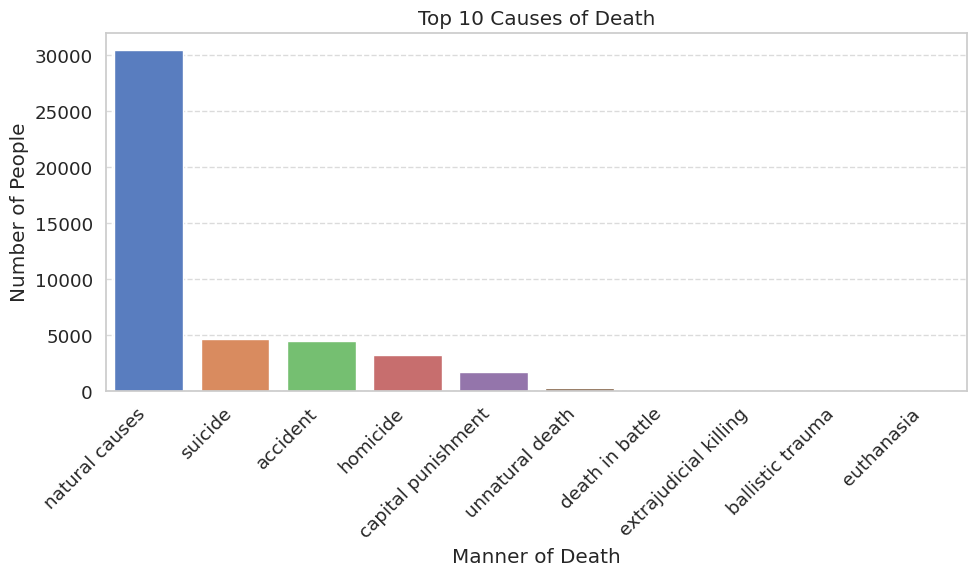

In [38]:
# Explode the 'Manner of death' column to create a new row for each element in the list
exploded_df = processed_df.explode('Manner of death')

# Get the top 10 ways of death
top_10_ways_of_death = exploded_df['Manner of death'].value_counts().nlargest(10)

# Create a bar plot using Seaborn
plt.figure(figsize=(10, 6))
sns.countplot(data=exploded_df, x='Manner of death', order=top_10_ways_of_death.index, palette='muted')
plt.title('Top 10 Causes of Death')
plt.xlabel('Manner of Death')
plt.ylabel('Number of People')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

## Data Visualization - What Occupation did they do?

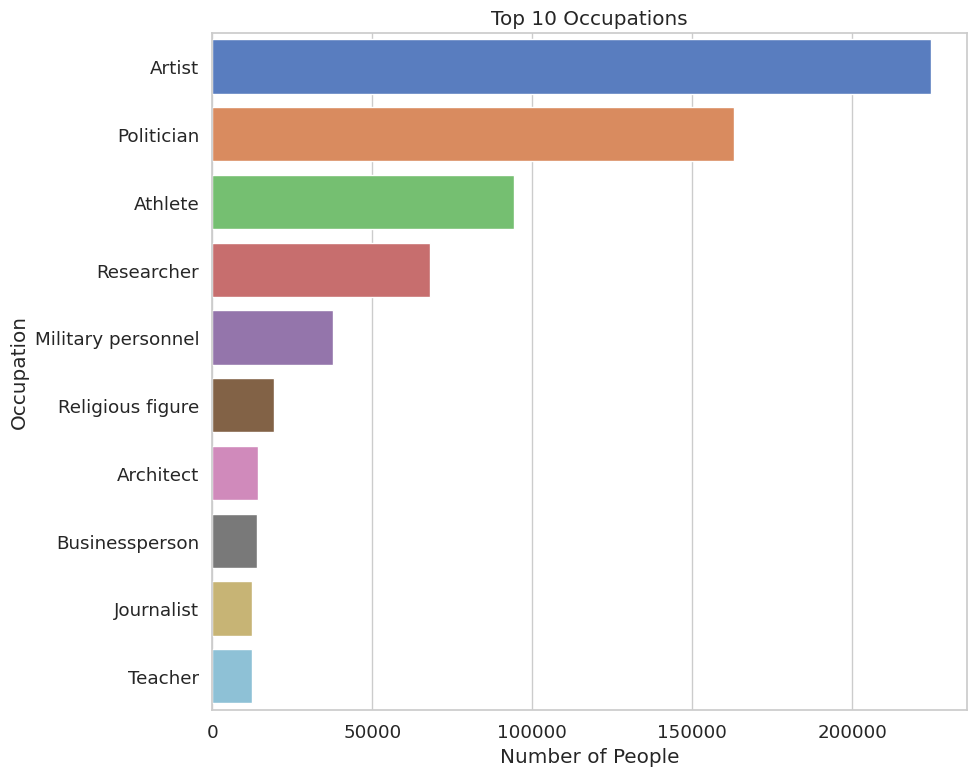

In [39]:
# Explode the 'Occupation' column to create a new row for each occupation in the list
exploded_df = processed_df.explode('Occupation')

# Get the counts of each occupation
occupation_counts = exploded_df['Occupation'].value_counts()

# Select only the top 10 occupations
top_10_occupations = occupation_counts.head(10)

# Create a horizontal bar plot using Seaborn
plt.figure(figsize=(10, 8))
sns.barplot(y=top_10_occupations.index, x=top_10_occupations.values, palette='muted')
plt.title('Top 10 Occupations')
plt.xlabel('Number of People')
plt.ylabel('Occupation')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

## In-Depth Visualization - Life Expectancy vs Gender

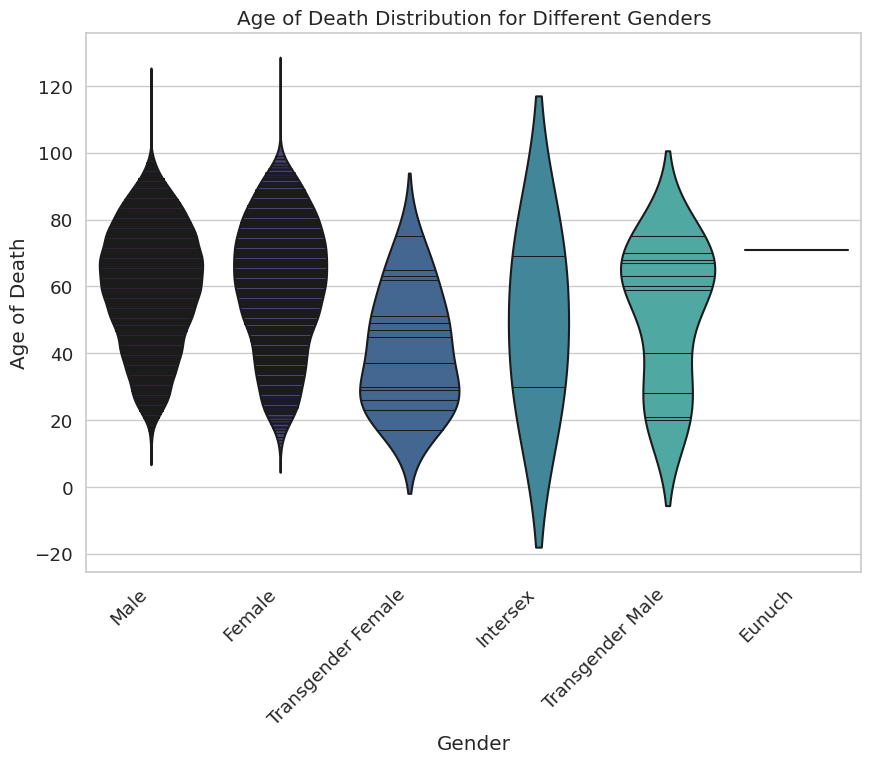

In [40]:
plt.figure(figsize=(10, 7))
sns.violinplot(data=processed_df.dropna(), x='Gender', y='Age of death', palette='mako', inner='stick')
plt.title('Age of Death Distribution for Different Genders')
plt.xlabel('Gender')
plt.ylabel('Age of Death')

# Adjust x-tick labels placement and rotation
plt.xticks(rotation=45, ha='right')

plt.show()

## In-Depth Visualization - Life Expectancy vs Birth Year

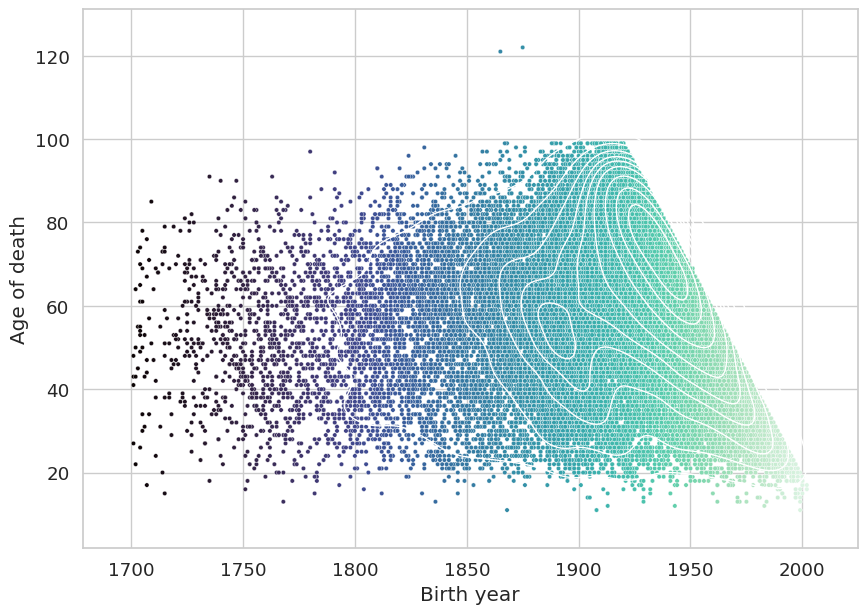

In [41]:
# Filter the DataFrame for birth year above 1700 and age of death above 1500
filtered_df = processed_df[(processed_df['Birth year'] > 1700)].dropna()


f, ax = plt.subplots(figsize=(10, 7))
sns.scatterplot(data=filtered_df, x='Birth year', y='Age of death', s=10, hue='Birth year', palette='mako', legend=False)
sns.kdeplot(data=filtered_df, x='Birth year', y='Age of death', levels=10, color="w", linewidths=1)

plt.show()

## Advanced Visualization - Is there a link Between Country and Manner of Death?

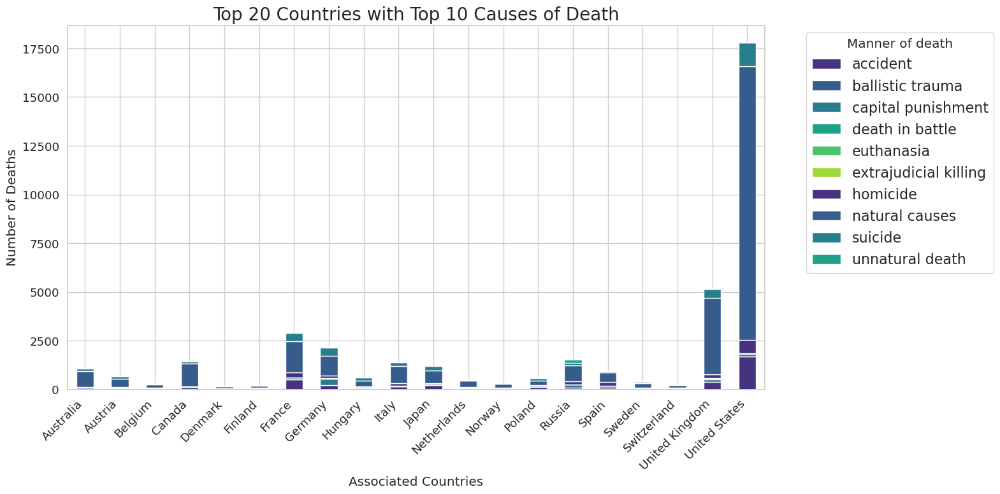

In [42]:
# Explode both 'Associated Countries' and 'Manner of death' columns
exploded_df = processed_df.explode('Associated Countries').explode('Manner of death').reset_index(drop=True)

# Get the top 20 countries
top_20_countries = exploded_df['Associated Countries'].value_counts().nlargest(20)

# Get the top 10 overall causes of death
top_10_manner_of_death = exploded_df['Manner of death'].value_counts().nlargest(10)

# Filter the exploded DataFrame to include only the top 20 countries and top 10 manner of death
filtered_df = exploded_df[exploded_df['Associated Countries'].isin(top_20_countries.index) &
                          exploded_df['Manner of death'].isin(top_10_manner_of_death.index)]

# Create a cross-tabulation to count occurrences of 'Manner of death' for each 'Associated Countries'
ct = pd.crosstab(filtered_df['Associated Countries'], filtered_df['Manner of death'])

# Create a stacked bar chart with counts
plt.figure(figsize=(16, 8))
sns.set_palette('viridis')
ax = ct.plot(kind='bar', stacked=True, ax=plt.gca())
plt.title('Top 20 Countries with Top 10 Causes of Death', fontdict={'fontsize': 20})
plt.xlabel('Associated Countries')
plt.ylabel('Number of Deaths')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Manner of death', bbox_to_anchor=(1.05, 1), loc='upper left', prop={'size': 16})
plt.tight_layout()
plt.show()

## Geo Visualization with Associated Countries

This might take a while to run :)

In [43]:
# Create a copy of processed_df for plotting the map
map_df = processed_df.copy()

# Explode the coordinates column
map_df = map_df.explode('Associated Countries')
map_df = map_df.explode('Associated Country Coordinates (Lat/Lon)')
map_df = map_df.dropna(subset=["Associated Country Coordinates (Lat/Lon)"])

# Extract 'Lat' and 'Lon' values using lambda function
map_df['Lat'] = map_df['Associated Country Coordinates (Lat/Lon)'].apply(lambda x: pd.Series(x[0]))
map_df['Lon'] = map_df['Associated Country Coordinates (Lat/Lon)'].apply(lambda x: pd.Series(x[1]))

# Drop rows with missing coordinates
map_df = map_df.dropna(subset=['Lat', 'Lon'], how="any")

# Create a Folium map
folium_map = folium.Map(location=[20, 0], zoom_start=2, tiles='CartoDB dark_matter')

# Add the FastMarkerCluster to the map
FastMarkerCluster(data=list(zip(map_df['Lat'].values, map_df['Lon'].values))).add_to(folium_map)

# Add layer control to the map
folium.LayerControl().add_to(folium_map)

# Display the map
folium_map

## First Name World Cloud

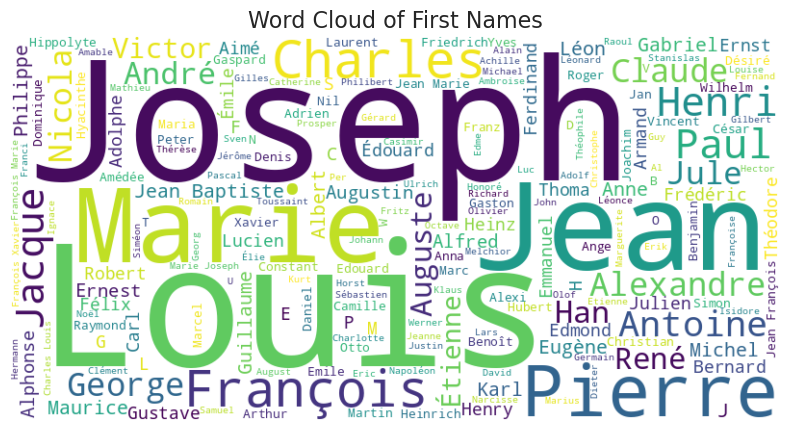

In [44]:
# Extract first names from the 'Name' column without modifying 'processed_df'
first_names_df = processed_df['Name'].str.split(expand=True)[0].str.strip().str.title()

# Create a set of unique first names
unique_first_names = set(first_names_df)

# Combine all unique first names into a single string
all_first_names = ' '.join(unique_first_names)

# Create a Word Cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_first_names)

# Visualize the Word Cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of First Names', fontsize=16)
plt.show()

## Last Name World Cloud

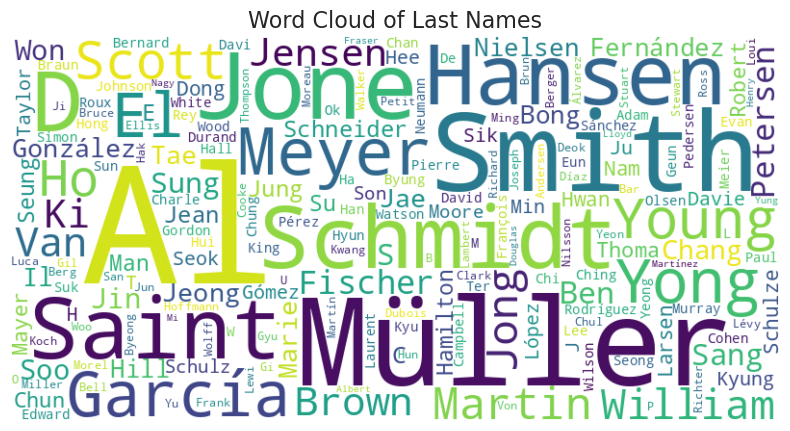

In [45]:
# Extract last names from the 'Name' column without modifying 'processed_df'
last_names_df = processed_df['Name'].str.split(expand=True)[1].str.strip().str.title()

# Create a set of unique last names and remove None values
unique_last_names = set(last_names_df.dropna())

# Combine all unique last names into a single string
all_last_names = ' '.join(unique_last_names)

# Create a Word Cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_last_names)

# Visualize the Word Cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Last Names', fontsize=16)
plt.show()

### Thank you for Reading the Full Notebook :). Please Upvote if you liked it.